<a href="https://colab.research.google.com/github/efacundoargana/Retriving_OSM/blob/main/Retrieving_OSM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install GDAL and Geopandas
!apt install gdal-bin python-gdal python3-gdal --quiet
!apt install python3-rtree --quiet
!pip install git+git://github.com/geopandas/geopandas.git --quiet
!pip install descartes --quiet
!pip install osmnx==0.10
!pip install folium

Reading package lists...
Building dependency tree...
Reading state information...
gdal-bin is already the newest version (2.2.3+dfsg-2).
python-gdal is already the newest version (2.2.3+dfsg-2).
python3-gdal is already the newest version (2.2.3+dfsg-2).
The following package was automatically installed and is no longer required:
  libnvidia-common-430
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 7 not upgraded.
Reading package lists...
Building dependency tree...
Reading state information...
The following package was automatically installed and is no longer required:
  libnvidia-common-430
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  libspatialindex-c4v5 libspatialindex-dev libspatialindex4v5
  python3-pkg-resources
Suggested packages:
  python3-setuptools
The following NEW packages will be installed:
  libspatialindex-c4v5 libspatialindex-dev libspatialindex4v5
  python3-pkg-resources python3-rtree
0 upg

In [ ]:
import pandas as pd
import geopandas as gpd
import osmnx as ox
import folium
import matplotlib.pyplot as plt
import seaborn as sns

## Streets

In [ ]:
place = "Ciudad Autónoma de Buenos Aires, Argentina"
graph = ox.graph_from_place(place, network_type='drive')

In [ ]:
len(graph)

17538

In [ ]:
nodes, streets = ox.graph_to_gdfs(graph)

In [ ]:
nodes.head()

,y,x,osmid,highway,ref,geometry
199294986,-34.599730,-58.509289,199294986,NaN,NaN,POINT (-58.50929 -34.59973)
199294995,-34.599831,-58.508436,199294995,NaN,NaN,POINT (-58.50844 -34.59983)
232587288,-34.637351,-58.490690,232587288,NaN,NaN,POINT (-58.49069 -34.63735)
199295010,-34.600146,-58.508190,199295010,NaN,NaN,POINT (-58.50819 -34.60015)
199295026,-34.599905,-58.507809,199295026,NaN,NaN,POINT (-58.50781 -34.59990)


In [ ]:
streets.head()

,u,v,key,osmid,oneway,name,highway,maxspeed,length,geometry,lanes,junction,bridge,ref,tunnel,service,width,access
0,199294986,6413280140,0,95337369,True,Avenida Lincoln,secondary,60,108.884,"LINESTRING (-58.50929 -34.59973, -58.51047 -34...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,199294986,177404807,0,405792249,True,Asunción,residential,40,94.103,"LINESTRING (-58.50929 -34.59973, -58.51010 -34...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,199294995,199295010,0,95337454,True,Joaquín Victor González,residential,40,41.610,"LINESTRING (-58.50844 -34.59983, -58.50819 -34...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,199294995,199294986,0,95337458,True,Avenida Lincoln,secondary,60,78.868,"LINESTRING (-58.50844 -34.59983, -58.50929 -34...",1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,232587288,232587652,0,21605804,True,Moreto,residential,40,151.529,"LINESTRING (-58.49069 -34.63735, -58.49107 -34...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
street_types = pd.DataFrame(streets["highway"].apply(pd.Series)[0].value_counts().reset_index())
street_types.columns = ["type", "count"]

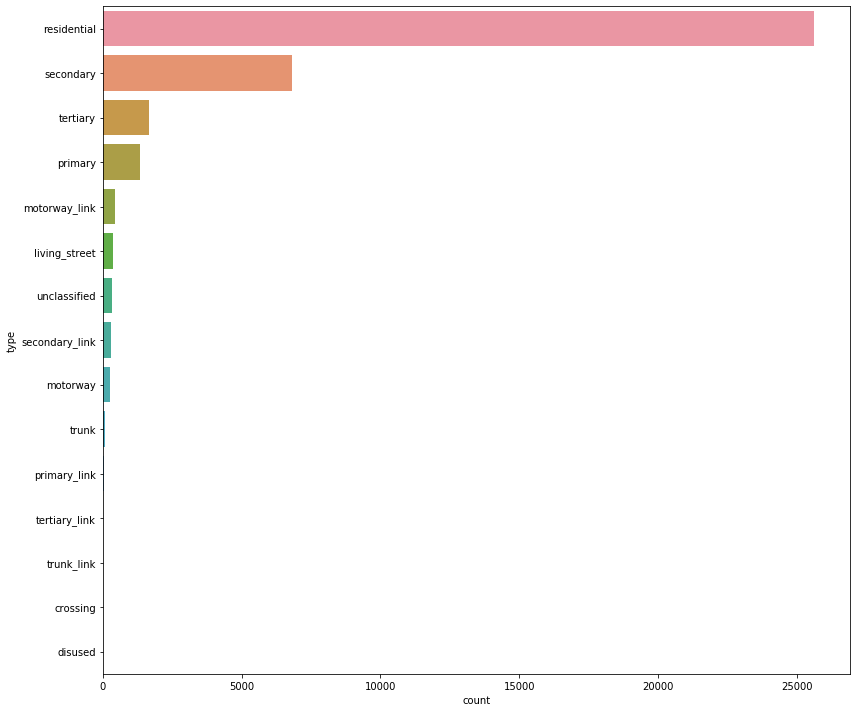

In [ ]:
fig, ax = plt.subplots(figsize=(12,10))
sns.barplot(y="type", x="count", data=street_types, ax=ax)
plt.tight_layout()
plt.savefig("barchart.png")

In [ ]:
style = {'color': '#F7DC6F', 'weight':'1'}
m = folium.Map([-34.580100, -58.431163],
               zoom_start=15,
               tiles="CartoDb dark_matter")
folium.GeoJson(streets, style_function=lambda x: style).add_to(m)
m.save("streets.html")
m

/usr/local/lib/python3.6/dist-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


## Building footprints

In [ ]:
buildings = ox.footprints_from_place(place)

In [ ]:
buildings.head()

,nodes,geometry,building,public_transport,addr:city,addr:housenumber,addr:postcode,addr:street,alt_name,amenity,architect,building:colour,building:levels,height,heritage,historic,name,official_name,old_name,short_name,start_date,website,wikidata,wikimedia_commons,wikipedia,building:use,healthcare,name:de,name:en,name:es,tourism,disused:name,phone,shop,contact:fax,contact:phone,contact:website,owner,description,fee,...,diet:vegan,ref:vatin,service_times,service:vehicle:diagnostics,service:vehicle:oil_change,service:vehicle:batteries,service:vehicle:motor,service:vehicle:air_conditioning,service:vehicle:body_repair,service:vehicle:car_parts,product,service:vehicle:electrical,addr:unit,female,male,rating,substation,voltage:primary,voltage:secondary,smoothness,abandoned:amenity,addr:number,indoor,room,tourism_1,payment:credit_cards,air_conditioning,bar,opening_date,company,architect:wikidata,architect:wikipedia,addr:state,voltage,bench,screen,addr:housename:de,landmark,obelisk:size,name:tr
4911986,"[2427310898, 32128674, 32128675, 2427310916, 2...","POLYGON ((-58.45514 -34.58654, -58.45545 -34.5...",train_station,station,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17444532,"[2715090656, 180517675, 180517676, 4960843336,...","POLYGON ((-58.36993 -34.60313, -58.36996 -34.6...",yes,NaN,Ciudad Autónoma de Buenos Aires,151,C1043AAN,Sarmiento,Palacio de Correos,arts_centre,Norberto Maillart,#ffffff,8,50,4,building,Centro Cultural Kirchner,Centro Cultural Presidente Néstor Kirchner,Correo Central,CCK,1928,http://www.culturalkirchner.gob.ar,Q3360763,File:Palacio de Correos Ciudad de Buenos Aires,es:Correo Central (Buenos Aires),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17495742,"[181175967, 258150663, 258150667, 258150674, 2...","POLYGON ((-58.40745 -34.58160, -58.40732 -34.5...",yes,NaN,NaN,NaN,NaN,NaN,NaN,hospital,NaN,NaN,NaN,NaN,NaN,NaN,Hospital Fernández,NaN,NaN,NaN,NaN,NaN,Q13360048,NaN,es:Hospital Fernández,hospital,hospital,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18514760,"[190996696, 190996708, 190996719, 190996730, 1...","POLYGON ((-58.39840 -34.58448, -58.39809 -34.5...",yes,NaN,NaN,NaN,NaN,NaN,NaN,library,NaN,NaN,NaN,NaN,NaN,NaN,Biblioteca Nacional Mariano Moreno,NaN,Biblioteca Nacional de la República Argentina,NaN,NaN,NaN,Q1319177,NaN,es:Biblioteca Nacional de la República Argentina,NaN,NaN,Nationalbibliothek Mariano Moreno,National Library Mariano Moreno,Biblioteca Nacional Mariano Moreno,attraction,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20424011,"[217953097, 217953116, 3810179987, 3810179983,...","POLYGON ((-58.40402 -34.57549, -58.40296 -34.5...",retail,NaN,NaN,NaN,NaN,NaN,Paseo Alcorta,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Alcorta Shopping,NaN,NaN,NaN,NaN,http://www.alcortashopping.com.ar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Paseo Alcorta,54 011 57776500,mall,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
buildings.shape

(36472, 317)

In [ ]:
cols = ['amenity','building', 'name', 'tourism']
buildings[cols].head()

,amenity,building,name,tourism
4911986,NaN,train_station,NaN,NaN
17444532,arts_centre,yes,Centro Cultural Kirchner,NaN
17495742,hospital,yes,Hospital Fernández,NaN
18514760,library,yes,Biblioteca Nacional Mariano Moreno,attraction
20424011,NaN,retail,Alcorta Shopping,NaN


In [ ]:
#list(buildings.columns)

In [ ]:
#buildings["amenity"].apply(pd.Series)[0].value_counts()


In [ ]:

style_buildings = {'color':'#6C3483 ', 'fillColor': '#6C3483 ', 'weight':'1', 'fillOpacity' : 1}

m = folium.Map([-26.402965, -54.634793],
               zoom_start=15,

               tiles="Stamen Toner")

folium.GeoJson(buildings[:5000], style_function=lambda x: style_buildings).add_to(m)
m.save("buildings.html")
m

/usr/local/lib/python3.6/dist-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


## Point of Interest - Cafes

In [ ]:
cafe = ox.pois_from_place(place, amenities=["cafe"])

In [ ]:
cafe.head()

,osmid,geometry,addr:city,addr:housenumber,addr:postcode,addr:street,amenity,name,website,element_type,email,name:ru,phone,smoking,wikidata,wikipedia,addr:country,cuisine,opening_hours,outdoor_seating,payment:credit_cards,brand,brand:wikidata,brand:wikipedia,delivery,drive_through,facebook,instagram,official_name,phone:AR,takeaway,twitter,wheelchair,source,internet_access,operator,internet_access:fee,shop,old_name,amenity_2,...,breakfast:brunch,organic,payment:american_express,payment:cash,payment:cryptocurrencies,payment:maestro,payment:mastercard,payment:visa,payment:visa_debit,name:es,amenity_1,contact:phone,addr:province,payment:coins,payment:visa_electron,toilets:wheelchair,bicycle_parking,start_date,name:en,name:fr,fixme,service:print,diet:vegetarian,name:ko,building,building:levels,prepayment:sube,service:copy,capacity,addr:flats,entrance,door,brewery,toilets,air_conditioning,nodes,area,building:colour,indoor,room
247463215,247463215,POINT (-58.41494 -34.58058),Ciudad Autonoma de Buenos Aires,3926,1425,Juan María Gutiérrez,cafe,Restaurant Museo Evita,https://www.museoevitaresto.com.ar/,node,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
331522003,331522003,POINT (-58.50572 -34.63951),NaN,NaN,NaN,NaN,cafe,bule-bar,NaN,node,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
340141702,340141702,POINT (-58.37815 -34.60870),NaN,829,NaN,Avenida de Mayo,cafe,Café Tortoni,http://www.cafetortoni.com.ar/,node,tortoni@cafetortoni.com.ar,Тортони,4342-4328,outside,Q1025674,es:Café Tortoni,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
668331794,668331794,POINT (-58.39083 -34.58787),Buenos Aires,596,C1129ABO,Avenida Presidente Quintana,cafe,Café La Biela,http://www.labiela.com,node,info@labiela.com,NaN,+54 11 4804-0449,NaN,Q5017245,es:La Biela,AR,ice_cream,"Mo-Su 00:00-02:00,07:00-24:00",yes,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
724259206,724259206,POINT (-58.36500 -34.62072),NaN,1896,NaN,Avenida Alicia Moreau de Justo,cafe,La Veneciana,NaN,node,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
cafe.shape

(1040, 103)

In [ ]:
cafe.columns

Index(['osmid', 'geometry', 'addr:city', 'addr:housenumber', 'addr:postcode',
       'addr:street', 'amenity', 'name', 'website', 'element_type',
       ...
       'entrance', 'door', 'brewery', 'toilets', 'air_conditioning', 'nodes',
       'area', 'building:colour', 'indoor', 'room'],
      dtype='object', length=103)

In [ ]:
columns =['osmid', 'name','wheelchair', 'opening_hours', 'addr:street', 'addr:city','addr:postcode']
cafe[columns].head()

,osmid,name,wheelchair,opening_hours,addr:street,addr:city,addr:postcode
247463215,247463215,Restaurant Museo Evita,NaN,NaN,Juan María Gutiérrez,Ciudad Autonoma de Buenos Aires,1425
331522003,331522003,bule-bar,NaN,NaN,NaN,NaN,NaN
340141702,340141702,Café Tortoni,NaN,NaN,Avenida de Mayo,NaN,NaN
668331794,668331794,Café La Biela,NaN,"Mo-Su 00:00-02:00,07:00-24:00",Avenida Presidente Quintana,Buenos Aires,C1129ABO
724259206,724259206,La Veneciana,NaN,NaN,Avenida Alicia Moreau de Justo,NaN,NaN


In [ ]:
cafe_points = cafe[cafe.geom_type == "Point"]

In [ ]:
m = folium.Map([-34.580100, -58.431163], zoom_start=10, tiles="CartoDb dark_matter")
locs = zip(cafe_points.geometry.y, cafe_points.geometry.x)
#folium.GeoJson(buildings, style_function=lambda x: style_buildings).add_to(m)
for location in locs:
    folium.CircleMarker(location=location,
        color = "#F4F6F7",   radius=2).add_to(m)
m.save("cafes.html")
m